# 1. Data Importing

##Download or learn more about the data from here: https://www.kaggle.com/competitions/nfl-big-data-bowl-2024/data

In [ ]:
competition_name = 'nfl-big-data-bowl-2024'
import os
# Check if the directory 'kaggle_data' exists
if not os.path.exists('kaggle_data'):
    # Mount your Google Drive.
    from google.colab import drive
    drive.mount("/content/drive")

    !pip install kaggle --quiet

    !mkdir ~/.kaggle
    !cp /content/drive/MyDrive/kaggle.json ~/.kaggle/kaggle.json
    !chmod 600 ~/.kaggle/kaggle.json

    !kaggle competitions download -c {competition_name}

    !mkdir kaggle_data
    !unzip {competition_name + ".zip"} -d kaggle_data

    # Unmount your Google Drive
    drive.flush_and_unmount()
else:
    print("The 'kaggle_data' directory already exists.")

Mounted at /content/drive
 91% 255M/279M [00:02<00:00, 167MB/s]
100% 279M/279M [00:02<00:00, 115MB/s]
Archive:  nfl-big-data-bowl-2024.zip
  inflating: kaggle_data/games.csv   
  inflating: kaggle_data/players.csv  
  inflating: kaggle_data/plays.csv   
  inflating: kaggle_data/tackles.csv  
  inflating: kaggle_data/tracking_week_1.csv  
  inflating: kaggle_data/tracking_week_2.csv  
  inflating: kaggle_data/tracking_week_3.csv  
  inflating: kaggle_data/tracking_week_4.csv  
  inflating: kaggle_data/tracking_week_5.csv  
  inflating: kaggle_data/tracking_week_6.csv  
  inflating: kaggle_data/tracking_week_7.csv  
  inflating: kaggle_data/tracking_week_8.csv  
  inflating: kaggle_data/tracking_week_9.csv  


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
from plotly.subplots import make_subplots
import math
from PIL import Image
from matplotlib import animation
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from IPython.display import HTML
%matplotlib inline

In [ ]:
players = pd.read_csv("kaggle_data/players.csv")
plays = pd.read_csv("kaggle_data/plays.csv")
games = pd.read_csv("kaggle_data/games.csv")
tackles = pd.read_csv("kaggle_data/tackles.csv")

weeks = [
    'kaggle_data/tracking_week_1.csv',
    'kaggle_data/tracking_week_2.csv',
    'kaggle_data/tracking_week_3.csv',
    'kaggle_data/tracking_week_4.csv',
    'kaggle_data/tracking_week_5.csv',
    'kaggle_data/tracking_week_6.csv',
    'kaggle_data/tracking_week_7.csv',
    'kaggle_data/tracking_week_8.csv'
]
week_dfs = list()
for week in weeks:
    week_dfs.append(pd.read_csv(week))
weeks = pd.concat(week_dfs)

In [ ]:
plays

,gameId,playId,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,...,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2
0,2022100908,3537,48723,Parker Hesse,(7:52) (Shotgun) M.Mariota pass short middle t...,4,1,10,ATL,TB,...,0.976785,0.023215,-0.006110,0.006110,2.360609,0.981955,NaN,NaN,NaN,NaN
1,2022091103,3126,52457,Chase Claypool,(7:38) (Shotgun) C.Claypool right end to PIT 3...,4,1,10,PIT,CIN,...,0.160485,0.839515,-0.010865,0.010865,1.733344,-0.263424,NaN,NaN,NaN,NaN
2,2022091111,1148,42547,Darren Waller,(8:57) D.Carr pass short middle to D.Waller to...,2,2,5,LV,LAC,...,0.756661,0.243339,-0.037409,0.037409,1.312855,1.133666,NaN,NaN,NaN,NaN
3,2022100212,2007,46461,Mike Boone,(13:12) M.Boone left tackle to DEN 44 for 7 ya...,3,2,10,DEN,LV,...,0.620552,0.379448,-0.002451,0.002451,1.641006,-0.043580,NaN,NaN,NaN,NaN
4,2022091900,1372,47857,Devin Singletary,(8:33) D.Singletary right guard to TEN 32 for ...,2,1,10,BUF,TEN,...,0.836290,0.163710,0.001053,-0.001053,3.686428,-0.167903,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12481,2022100204,123,43293,Ezekiel Elliott,(13:31) E.Elliott right tackle to WAS 38 for 1...,1,1,10,DAL,WAS,...,0.638600,0.361400,-0.011542,0.011542,3.642571,-0.504018,NaN,NaN,NaN,NaN
12482,2022091200,3467,46189,Will Dissly,(6:08) G.Smith pass short right to W.Dissly to...,4,1,10,SEA,DEN,...,0.615241,0.384759,-0.025458,0.025458,1.434580,-0.444642,NaN,NaN,NaN,NaN
12483,2022101605,3371,44860,Joe Mixon,(9:35) (Shotgun) J.Mixon left end to CIN 47 fo...,4,1,10,CIN,NO,...,0.667054,0.332946,-0.005164,0.005164,2.115356,0.203819,NaN,NaN,NaN,NaN
12484,2022100207,2777,52449,Jonathan Taylor,(2:02) (Shotgun) J.Taylor up the middle to TEN...,3,1,10,IND,TEN,...,0.410611,0.589389,-0.046648,0.046648,3.946232,-0.976039,NaN,NaN,NaN,NaN


In [ ]:
players

,nflId,height,weight,birthDate,collegeName,position,displayName
0,25511,6-4,225,1977-08-03,Michigan,QB,Tom Brady
1,29550,6-4,328,1982-01-22,Arkansas,T,Jason Peters
2,29851,6-2,225,1983-12-02,California,QB,Aaron Rodgers
3,30842,6-6,267,1984-05-19,UCLA,TE,Marcedes Lewis
4,33084,6-4,217,1985-05-17,Boston College,QB,Matt Ryan
...,...,...,...,...,...,...,...
1678,55200,6-6,266,NaN,Indiana,DT,Ryder Anderson
1679,55212,6-0,230,NaN,Iowa State,ILB,Jake Hummel
1680,55239,6-2,300,NaN,Pennsylvania,DT,Prince Emili
1681,55240,6-1,185,NaN,Buffalo,CB,Ja'Marcus Ingram


In [ ]:
weeks

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event
0,2022090800,56,35472.0,Rodger Saffold,1,2022-09-08 20:24:05.200000,76.0,BUF,left,88.370000,27.270000,1.62,1.15,0.16,231.74,147.90,NaN
1,2022090800,56,35472.0,Rodger Saffold,2,2022-09-08 20:24:05.299999,76.0,BUF,left,88.470000,27.130000,1.67,0.61,0.17,230.98,148.53,pass_arrived
2,2022090800,56,35472.0,Rodger Saffold,3,2022-09-08 20:24:05.400000,76.0,BUF,left,88.560000,27.010000,1.57,0.49,0.15,230.98,147.05,NaN
3,2022090800,56,35472.0,Rodger Saffold,4,2022-09-08 20:24:05.500000,76.0,BUF,left,88.640000,26.900000,1.44,0.89,0.14,232.38,145.42,NaN
4,2022090800,56,35472.0,Rodger Saffold,5,2022-09-08 20:24:05.599999,76.0,BUF,left,88.720000,26.800000,1.29,1.24,0.13,233.36,141.95,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1406767,2022103100,3697,NaN,football,33,2022-10-31 23:05:05.200000,NaN,football,left,19.770000,25.799999,1.22,1.78,0.13,NaN,NaN,tackle
1406768,2022103100,3697,NaN,football,34,2022-10-31 23:05:05.299999,NaN,football,left,19.680000,25.879999,1.09,1.40,0.12,NaN,NaN,NaN
1406769,2022103100,3697,NaN,football,35,2022-10-31 23:05:05.400000,NaN,football,left,19.600000,25.950001,0.92,1.28,0.10,NaN,NaN,NaN
1406770,2022103100,3697,NaN,football,36,2022-10-31 23:05:05.500000,NaN,football,left,19.540001,26.000000,0.79,1.12,0.08,NaN,NaN,NaN


In [ ]:
tackles

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle
0,2022090800,101,42816,1,0,0,0
1,2022090800,393,46232,1,0,0,0
2,2022090800,486,40166,1,0,0,0
3,2022090800,646,47939,1,0,0,0
4,2022090800,818,40107,1,0,0,0
...,...,...,...,...,...,...,...
17421,2022091113,2494,43533,0,0,0,1
17422,2022092502,3510,42406,0,0,0,1
17423,2022091113,3642,43478,0,0,0,1
17424,2022091901,3578,42431,0,0,0,1


In [ ]:
games

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,homeFinalScore,visitorFinalScore
0,2022090800,2022,1,09/08/2022,20:20:00,LA,BUF,10,31
1,2022091100,2022,1,09/11/2022,13:00:00,ATL,NO,26,27
2,2022091101,2022,1,09/11/2022,13:00:00,CAR,CLE,24,26
3,2022091102,2022,1,09/11/2022,13:00:00,CHI,SF,19,10
4,2022091103,2022,1,09/11/2022,13:00:00,CIN,PIT,20,23
...,...,...,...,...,...,...,...,...,...
131,2022110607,2022,9,11/06/2022,13:00:00,WAS,MIN,17,20
132,2022110608,2022,9,11/06/2022,16:05:00,ARI,SEA,21,31
133,2022110609,2022,9,11/06/2022,16:25:00,TB,LA,16,13
134,2022110610,2022,9,11/06/2022,20:20:00,KC,TEN,20,17


# 2. About the Players

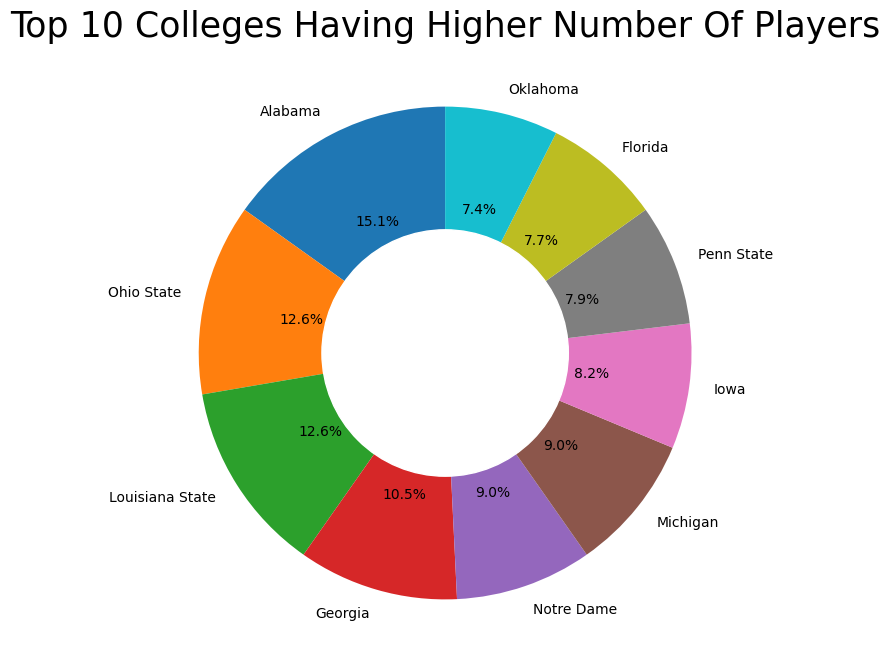

In [ ]:
top_colleges = players['collegeName'].value_counts()
top_colleges = top_colleges[:10]
fig = plt.figure(figsize = (8, 8))
circle = plt.Circle( (0,0), 0.5, color = 'white')
plt.pie(top_colleges[:], labels = top_colleges.index, autopct='%1.1f%%', startangle=90)
p = plt.gcf()
p.gca().add_artist(circle)
plt.title("Top 10 Colleges Having Higher Number Of Players", fontsize=25)

# Displaying Donut Plot
plt.show()

#### Positions explained
QB: Quarterback,
T: Tackle,
TE: Tight End,
WR: Wide Receiver,
DE: Defensive End,
NT: Nose Tackle,
SS: Strong Safety,
FS: Free Safety,
G: Guard,
OLB: Outside Linebacker,
DT: Defensive Tackle,
CB: Cornerback,
RB: Running Back,
C: Center,
ILB: Inside Linebacker,
MLB: Middle Linebacker,
FB: Fullback,
LS: Long Snapper,
DB: Defensive Back,

In [ ]:
positions = players['position'].value_counts()
positions = pd.DataFrame({'Position': positions.index, 'Count': positions.values})
fig = px.bar(positions, x="Position", y="Count", title="Frequently Used To Least Used Positions", color=positions["Count"])
fig.show(renderer = 'colab')

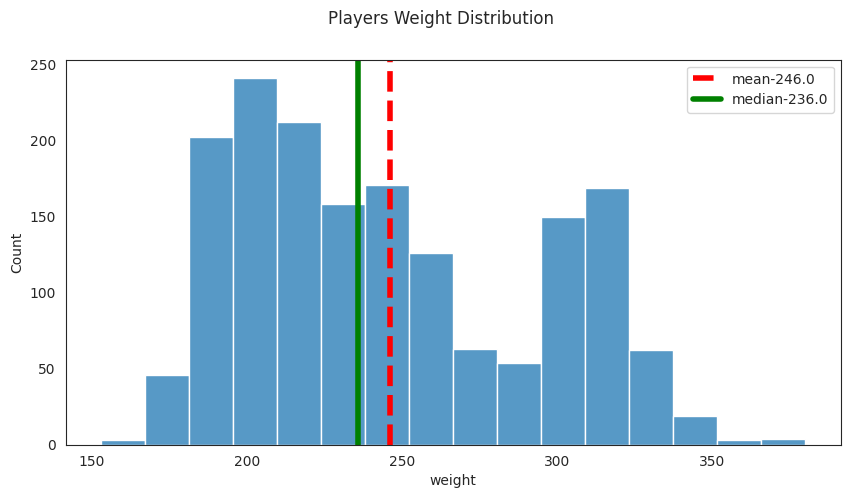

In [ ]:
mean=np.ceil(players['weight'].mean())
median=np.ceil(players['weight'].median())
plt.figure(figsize=(10, 5))
sns.set_style('white')
hist_plot = sns.histplot(players['weight'], )
hist_plot.axvline(mean, color='r', linestyle='--', linewidth = 4, label = f'mean-{mean}')
hist_plot.axvline(median, color='g', linestyle='-', linewidth = 4, label = f'median-{median}')
plt.suptitle("Players Weight Distribution")
plt.legend()
plt.show()

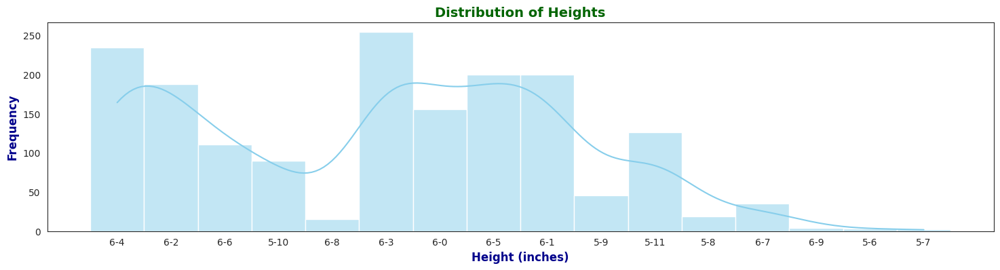

count     1683
unique      16
top        6-3
freq       254
Name: height, dtype: object


In [ ]:
plt.figure(figsize=(18, 4))
sns.histplot(data=players, x='height', kde=True, color='skyblue', bins=5)
plt.title('Distribution of Heights', fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Height (inches)', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Frequency', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.show()

print(players['height'].describe())


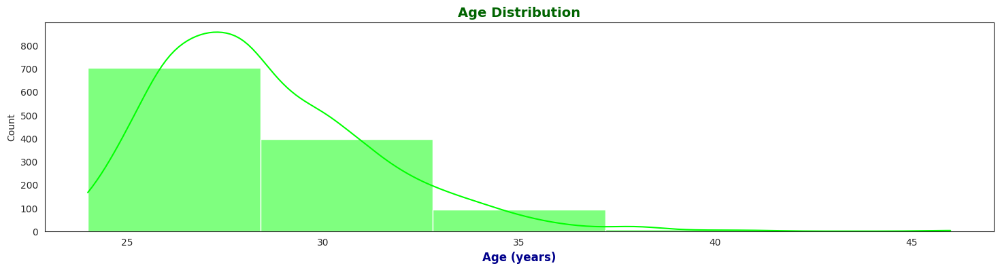

count    1204.000000
mean       28.467608
std         2.751216
min        24.000000
25%        26.000000
50%        28.000000
75%        30.000000
max        46.000000
Name: age, dtype: float64


In [ ]:
from datetime import datetime
# Calculate age from birth year
current_year = datetime.now().year
players['birthYear'] = pd.DatetimeIndex(players['birthDate']).year
players['age'] = current_year - players['birthYear']

# Age Distribution
plt.figure(figsize=(18, 4))
sns.histplot(data=players, x='age', kde=True, color='lime', bins=5)
plt.title('Age Distribution', fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Age (years)', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.show()

print(players['age'].describe())

In [ ]:
players['height'] = players['height'].astype('str')
players['height'] = players['height'].str.replace('-', '.')
players['height'] = players['height'].astype('float')

formats = ["%Y-%m-%d", "%m/%d/%Y"]
parsed_dt = pd.to_datetime(players.birthDate, format=formats[0], errors='coerce')
for format in formats[1:]:
    parsed_dt = parsed_dt.fillna(pd.to_datetime(players.birthDate, format=format, errors='coerce'))

players['birthDate'] = parsed_dt

def group_position(position):
    if position in ['QB', 'T', 'TE', 'WR', 'C', 'G', 'RB', 'FB']:
        return 'offensive'
    return 'defensive'


players['position_group'] = players['position'].apply(group_position)

# formula inherited from https://www.calculatorsoup.com/calculators/health/bmi-calculator.php
players['mass_index'] = players['weight']/( players['height'] * players['height'] )

players.mass_index = players.mass_index.round(2)

def group_index(index):
    bmi_lower_fence = 4.4
    bmi_q1 = 5.66
    bmi_median = 6.37
    bmi_q3 = 7.38

    if index < bmi_q1:
        return 'S'
    elif bmi_q1 <= index < bmi_median:
        return 'M'
    elif bmi_median <= index < bmi_q3:
        return 'L'
    else:
        return 'XL'

players['bmi_group'] = players['mass_index'].apply(group_index)

today = datetime.today()

players['age'] = players['birthDate'].apply(
               lambda x: today.year - x.year -
               ((today.month, today.day) < (x.month, x.day))
               )

players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1683 entries, 0 to 1682
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   nflId           1683 non-null   int64         
 1   height          1683 non-null   float64       
 2   weight          1683 non-null   int64         
 3   birthDate       1204 non-null   datetime64[ns]
 4   collegeName     1683 non-null   object        
 5   position        1683 non-null   object        
 6   displayName     1683 non-null   object        
 7   birthYear       1204 non-null   float64       
 8   age             1204 non-null   float64       
 9   position_group  1683 non-null   object        
 10  mass_index      1683 non-null   float64       
 11  bmi_group       1683 non-null   object        
dtypes: datetime64[ns](1), float64(4), int64(2), object(5)
memory usage: 157.9+ KB


In [ ]:
fig = px.histogram(players, x="mass_index", marginal="rug",
                   title='Distribution of Players by Body Mass Index (BMI)',
                   color_discrete_sequence=px.colors.qualitative.Prism)
fig.show()

In [ ]:
fig = px.box(players, x="mass_index",
                   title='Summary Statistics on Players by Body Mass Index (BMI)',
                   color_discrete_sequence=px.colors.qualitative.Prism)
fig.show()

# 3. About the Weeks

In [ ]:
check = weeks[weeks['event'] != 'None']
check = check['event'].value_counts().reset_index()
check.columns = ['event', 'actions']
check = check.sort_values('actions')

fig = px.bar(
    check,
    y='event',
    x="actions",
    orientation='h',
    title='Events',
    color_discrete_sequence=['crimson'],
    height=1000,
    width=800
)

fig.show()

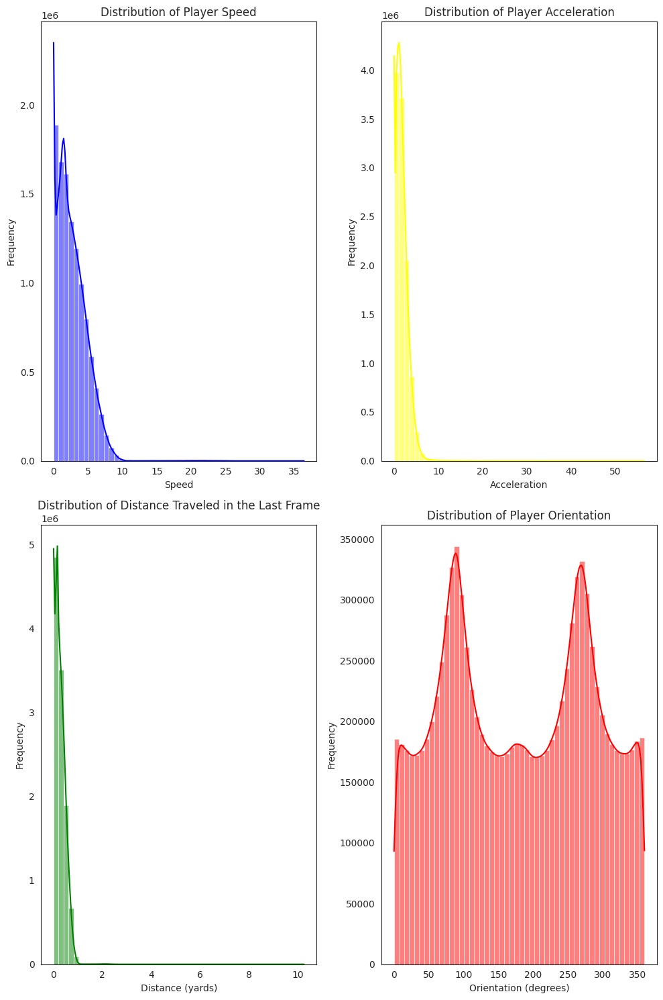

In [ ]:
# Setting up the subplots for visualization
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 15))

# Distribution of 's' (Speed)

sns.histplot(weeks['s'], bins=50, kde=True, ax=axes[0][0], color='blue')
axes[0][0].set_title('Distribution of Player Speed')
axes[0][0].set_xlabel('Speed')
axes[0][0].set_ylabel('Frequency')

# Distribution of 'a' (Acceleration)
sns.histplot(weeks['a'], bins=50, kde=True, ax=axes[0][1], color='yellow')
axes[0][1].set_title('Distribution of Player Acceleration')
axes[0][1].set_xlabel('Acceleration')
axes[0][1].set_ylabel('Frequency')

# Distribution of 'dis' (Distance traveled in the last frame)
sns.histplot(weeks['dis'], bins=50, kde=True, ax=axes[1][0], color='green')
axes[1][0].set_title('Distribution of Distance Traveled in the Last Frame')
axes[1][0].set_xlabel('Distance (yards)')
axes[1][0].set_ylabel('Frequency')

# Distribution of 'o' (Orientation)
sns.histplot(weeks['o'], bins=50, kde=True, ax=axes[1][1], color='red')
axes[1][1].set_title('Distribution of Player Orientation')
axes[1][1].set_xlabel('Orientation (degrees)')
axes[1][1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

# 4. About the Tackles

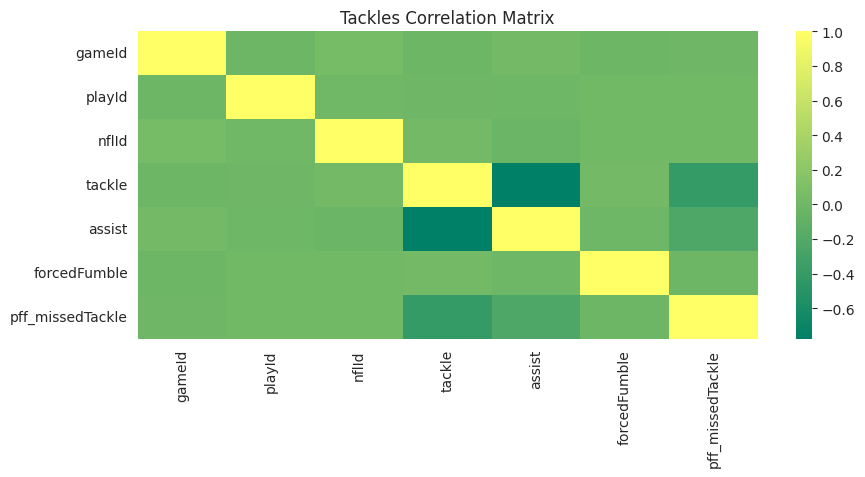

In [ ]:
dfcorr=tackles.corr()
dfcorr
plt.figure(figsize=(10,4))
sns.heatmap(tackles.corr(),annot=False,cmap='summer')
plt.title('Tackles Correlation Matrix')
plt.show()

In [ ]:
tackle_games = tackles.groupby(['gameId'])['tackle'].agg('sum')

frame = {'game_id': tackle_games.index,
         'tackles': tackle_games}

# Creating DataFrame by passing Dictionary
agg_data = pd.DataFrame(frame).reset_index()
agg_data = agg_data.drop(columns=['game_id'], axis=1)

fig = px.histogram(agg_data, x="tackles", marginal="rug",
                   title='Distribution of Tackles per Game',
                   color_discrete_sequence=px.colors.qualitative.Prism)
fig.show()

In [ ]:
tackle_players = tackles.groupby(['nflId'])['tackle'].agg('sum')

frame = {'nfl_id': tackle_players.index,
         'tackles': tackle_players}

# Creating DataFrame by passing Dictionary
agg_data = pd.DataFrame(frame).reset_index()
agg_data = agg_data.drop(columns=['nfl_id'], axis=1)

fig = px.histogram(agg_data, x="tackles", marginal="rug",
                   title='Distribution of Tackles by Players',
                   color_discrete_sequence=px.colors.qualitative.Prism)
fig.show()

In [ ]:
# This one incorporates defensive from players
fig = make_subplots(rows=4, cols=1, subplot_titles=(
    '<b>Summary Statistics on Players by Tackles and Defensive Roles</b>',
    '<b>Summary Statistics on Players by Assists and Defensive Roles</b>',
    '<b>Summary Statistics on Players by Forced Fumbles and Defensive Roles</b>',
    '<b>Summary Statistics on Players by Missed Tackles and Defensive Roles</b>',
))
agg_dict_1 = {
    "tackles": pd.NamedAgg(column='tackle', aggfunc='sum'),
    "assists": pd.NamedAgg(column='assist', aggfunc='sum'),
    "forced_fumbles": pd.NamedAgg(column='forcedFumble', aggfunc='sum'),
    "missed_tackles": pd.NamedAgg(column='pff_missedTackle', aggfunc='sum'),
}

player_tackle_df = tackles.groupby("nflId").agg(**agg_dict_1).reset_index()


player_tackles = pd.merge(
    players,
    player_tackle_df,
    how="inner",
    on=['nflId']
)

fig.add_trace(go.Box(x=player_tackles['position'],y=player_tackles['tackles']), row=1, col=1)
fig.add_trace(go.Box(x=player_tackles['position'],y=player_tackles['assists']), row=2, col=1)
fig.add_trace(go.Box(x=player_tackles['position'],y=player_tackles['forced_fumbles']), row=3, col=1)
fig.add_trace(go.Box(x=player_tackles['position'],y=player_tackles['missed_tackles']), row=4, col=1)

# Update visual layout
fig.update_layout(
    showlegend=False,
    width=900,
    height=400,
    autosize=False,
    margin=dict(t=15, b=0, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [ ]:
agg_dict_1 = {
    "tackles": pd.NamedAgg(column='tackle', aggfunc='sum'),
    "assists": pd.NamedAgg(column='assist', aggfunc='sum'),
    "forced_fumbles": pd.NamedAgg(column='forcedFumble', aggfunc='sum'),
    "missed_tackles": pd.NamedAgg(column='pff_missedTackle', aggfunc='sum'),
}

play_tackle_df = tackles.groupby(["gameId", "playId"]).agg(**agg_dict_1).reset_index()


play_tackles = pd.merge(
    plays,
    play_tackle_df,
    how="outer",
    on=["gameId", "playId"]
)
values = {"tackles": -1.0, "assists": -1.0, "forced_fumbles": -1.0, "missed_tackles": -1.0}
play_tackles = play_tackles.fillna(value=values)

play_tackles = play_tackles.astype({"tackles":'int', "assists":'int',
                                    "forced_fumbles":'int', "missed_tackles":'int',})

play_tackles.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 12486 entries, 0 to 12485
Data columns (total 39 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   gameId                            12486 non-null  int64  
 1   playId                            12486 non-null  int64  
 2   ballCarrierId                     12486 non-null  int64  
 3   ballCarrierDisplayName            12486 non-null  object 
 4   playDescription                   12486 non-null  object 
 5   quarter                           12486 non-null  int64  
 6   down                              12486 non-null  int64  
 7   yardsToGo                         12486 non-null  int64  
 8   possessionTeam                    12486 non-null  object 
 9   defensiveTeam                     12486 non-null  object 
 10  yardlineSide                      12319 non-null  object 
 11  yardlineNumber                    12486 non-null  int64  
 12  game

In [ ]:
successful_tackle_plays = play_tackles[play_tackles['tackles'] > 0]

agg_data = successful_tackle_plays[["quarter", "down"]].groupby(["quarter", "down"]).size().reset_index(name="count")

di =  {1: "Q1", 2: "Q2", 3: "Q3", 4: "Q4", 5: "Q5"}
agg_data['quarter'] = agg_data['quarter'].map(di)

di =  {1: "D1", 2: "D2", 3: "D3", 4: "D4"}
agg_data['down'] = agg_data['down'].map(di)

# define figure element
fig = px.sunburst(
    agg_data,
    values='count',
    path=["quarter", "down"],
    title="Successful tackles in plays by quarter and down",
    color="quarter",
    height=600,
    color_discrete_sequence=px.colors.qualitative.Prism,
    #color_continuous_scale=px.colors.sequential.Viridis
)
# display the figure
fig.show()

# 5. About the Games

#### The teams
LA: Los Angeles (referring to either the Los Angeles Rams or the Los Angeles Chargers),
ATL: Atlanta Falcons,
CAR: Carolina Panthers,
CHI: Chicago Bears,
CIN: Cincinnati Bengals,
DET: Detroit Lions,
HOU: Houston Texans,
MIA: Miami Dolphins,
NYJ: New York Jets,
WAS: Washington Football Team (formerly known as the Washington Redskins),
ARI: Arizona Cardinals,
LAC: Los Angeles Chargers,
MIN: Minnesota Vikings,
TEN: Tennessee Titans,
DAL: Dallas Cowboys,
SEA: Seattle Seahawks,
KC: Kansas City Chiefs,
BAL: Baltimore Ravens,
CLE: Cleveland Browns,
JAX: Jacksonville Jaguars,
NO: New Orleans Saints,
NYG: New York Giants,
PIT: Pittsburgh Steelers,
SF: San Francisco 49ers,
DEN: Denver Broncos,
LV: Las Vegas Raiders,
GB: Green Bay Packers,
BUF: Buffalo Bills,
PHI: Philadelphia Eagles,
IND: Indianapolis Colts,
NE: New England Patriots,
TB: Tampa Bay Buccaneers,

In [ ]:
home = games['homeTeamAbbr'].value_counts()
home = pd.DataFrame({"Home Team": home.index, 'Counts': home.values})
fig = px.bar(home, x="Home Team", y="Counts", title="NFL Home Teams", color="Counts")
fig.show()

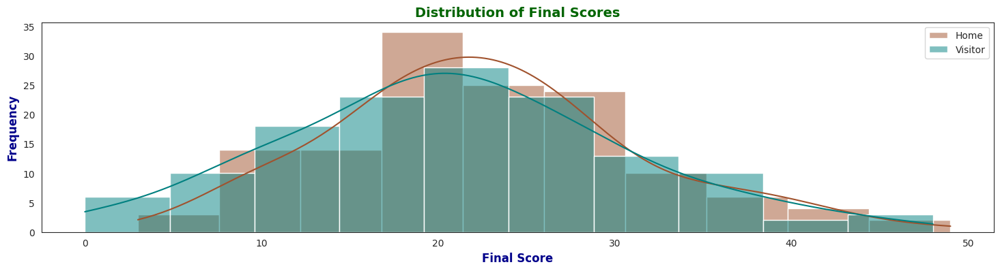

       homeFinalScore  visitorFinalScore
count      136.000000         136.000000
mean        22.669118          20.948529
std          8.659874           9.731446
min          3.000000           0.000000
25%         17.000000          14.750000
50%         22.500000          20.000000
75%         27.000000          27.000000
max         49.000000          48.000000


In [ ]:
# Distribution of game results
plt.figure(figsize=(18, 4))
sns.histplot(data=games, x='homeFinalScore', kde=True, color='sienna', bins=10, label='Home')
sns.histplot(data=games, x='visitorFinalScore', kde=True, color='teal', bins=10, label='Visitor')
plt.title('Distribution of Final Scores', fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Final Score', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Frequency', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.legend()
plt.show()

print(games[['homeFinalScore', 'visitorFinalScore']].describe())

In [ ]:
agg_dict_1 = {
    "min_home_score": pd.NamedAgg(column='homeFinalScore', aggfunc='min'),
    "max_home_score": pd.NamedAgg(column='homeFinalScore', aggfunc='max'),
    "avg_home_score": pd.NamedAgg(column='homeFinalScore', aggfunc=np.mean),

}

agg_data = games.groupby("homeTeamAbbr").agg(**agg_dict_1).reset_index()

fig = go.Figure()

fig.add_bar(x=agg_data['homeTeamAbbr'],y=agg_data['min_home_score'],
            hovertext="Minimal score in home games", name="min_home_score",
            marker_color=px.colors.qualitative.Prism[0])    # "orange"
fig.add_bar(x=agg_data['homeTeamAbbr'],y=agg_data['avg_home_score'],
            hovertext="Average score in home games", name="avg_home_score",
            marker_color=px.colors.qualitative.Prism[1]) # "green"
fig.add_bar(x=agg_data['homeTeamAbbr'],y=agg_data['max_home_score'],
            hovertext="Maximal score in home games", name="max_home_score",
            marker_color=px.colors.qualitative.Prism[2]) # "green"

# Update visual layout
fig.update_layout(
    showlegend=True,
    width=800,
    height=400,
    autosize=False,
    margin=dict(t=30, b=0, l=5, r=5),
    template="plotly_white",
    yaxis_title="Scores",
    title=dict(text='Scores in Home Games by Teams', font=dict(size=20), yref='paper')
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [ ]:
agg_dict_2 = {
    "min_away_score": pd.NamedAgg(column='visitorFinalScore', aggfunc='min'),
    "max_away_score": pd.NamedAgg(column='visitorFinalScore', aggfunc='max'),
    "avg_away_score": pd.NamedAgg(column='visitorFinalScore', aggfunc=np.mean)
}

agg_data = games.groupby("visitorTeamAbbr").agg(**agg_dict_2).reset_index()

fig = go.Figure()

fig.add_bar(x=agg_data['visitorTeamAbbr'],y=agg_data['min_away_score'],
            hovertext="Minimal score in away games", name="min_away_score",
            marker_color=px.colors.qualitative.Prism[0])    # "orange"
fig.add_bar(x=agg_data['visitorTeamAbbr'],y=agg_data['avg_away_score'],
            hovertext="Average score in away games", name="avg_away_score",
            marker_color=px.colors.qualitative.Prism[1]) # "green"
fig.add_bar(x=agg_data['visitorTeamAbbr'],y=agg_data['max_away_score'],
            hovertext="Maximal score in away games", name="max_away_score",
            marker_color=px.colors.qualitative.Prism[2]) # "green"

# Update visual layout
fig.update_layout(
    showlegend=True,
    width=800,
    height=400,
    autosize=False,
    margin=dict(t=30, b=0, l=5, r=5),
    template="plotly_white",
    yaxis_title="Scores",
    title=dict(text='Scores in Away Games by Teams', font=dict(size=20), yref='paper')
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

# 6. About the Plays

In [ ]:
formations = plays["offenseFormation"].value_counts()
formations = pd.DataFrame({"Formation": formations.index, 'Counts': formations.values})
fig = px.bar(formations, x="Formation", y="Counts", title="NFL Offense Formations", color="Counts")
fig.show(renderer = 'colab')

In [ ]:
yardlines = plays['absoluteYardlineNumber'].value_counts()
yardlines = pd.DataFrame({"Absolute YardLine Number": yardlines.index, 'Counts': yardlines.values})
fig = px.bar(yardlines, x="Absolute YardLine Number", y="Counts", title="NFL Absolute Yard Line Number", color="Absolute YardLine Number")
fig.show(renderer = 'colab')

# 7. Pitch Diagrams

## All player vectors on field

In [ ]:
week_1 = pd.read_csv('kaggle_data/tracking_week_1.csv')
play_1 = week_1[(week_1['gameId'] == 2022090800) & (week_1['playId'] == 2648)]

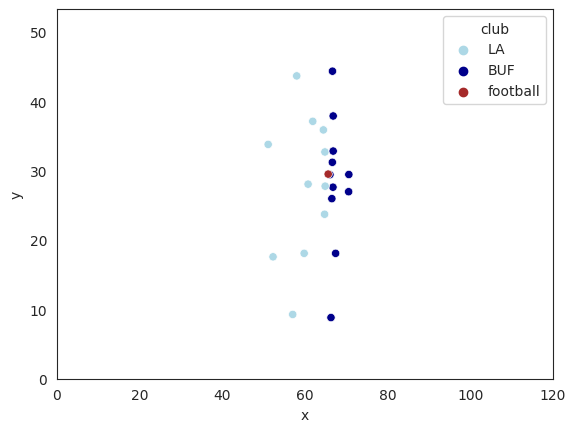

In [ ]:
#1 Frame
temp = play_1[play_1['frameId'] == 1]
plot = sns.scatterplot(data=temp, x='x', y='y', hue='club', palette=['lightblue', 'darkblue', 'brown'])
plt.xlim(0, 120)
plt.ylim(0, 53.3)
plt.show()

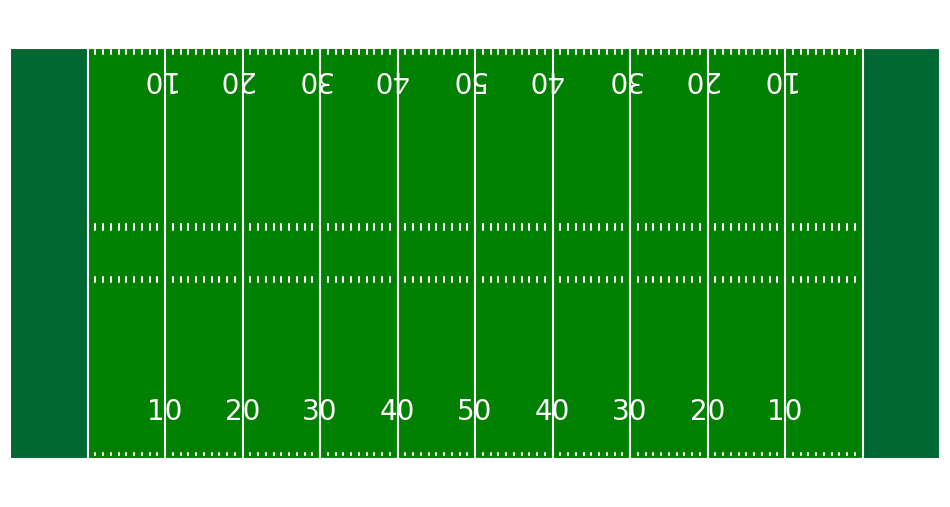

In [ ]:
#Sourced from here: https://www.kaggle.com/code/robikscube/nfl-big-data-bowl-plotting-player-position
def create_football_field(linenumbers=True,
                          endzones=True,
                          highlight_line=False,
                          highlight_line_number=50,
                          highlighted_name='Line of Scrimmage',
                          fifty_is_los=False,
                          figsize=(12, 6.33)):
    """
    Function that plots the football field for viewing plays.
    Allows for showing or hiding endzones.
    """
    rect = patches.Rectangle((0, 0), 120, 53.3, linewidth=0.1,
                             edgecolor='r', facecolor='green',zorder=0)

    fig, ax = plt.subplots(1, figsize=figsize)
    ax.add_patch(rect)

    plt.plot([10, 10, 10, 20, 20, 30, 30, 40, 40, 50, 50, 60, 60, 70, 70, 80,
              80, 90, 90, 100, 100, 110, 110, 120, 0, 0, 120, 120],
             [0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3,
              53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 53.3, 0, 0, 53.3],
             color='white')
    if fifty_is_los:
        plt.plot([60, 60], [0, 53.3], color='gold')
        plt.text(62, 50, '<- Player Yardline at Snap', color='gold')
    # Endzones
    if endzones:
        ez1 = patches.Rectangle((0, 0), 10, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ez2 = patches.Rectangle((110, 0), 120, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ax.add_patch(ez1)
        ax.add_patch(ez2)
    plt.xlim(0, 120)
    plt.ylim(-5, 58.3)
    plt.axis('off')
    if linenumbers:
        for x in range(20, 110, 10):
            numb = x
            if x > 50:
                numb = 120 - x
            plt.text(x, 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white')
            plt.text(x - 0.95, 53.3 - 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white', rotation=180)
    if endzones:
        hash_range = range(11, 110)
    else:
        hash_range = range(1, 120)

    for x in hash_range:
        ax.plot([x, x], [0.4, 0.7], color='white')
        ax.plot([x, x], [53.0, 52.5], color='white')
        ax.plot([x, x], [22.91, 23.57], color='white')
        ax.plot([x, x], [29.73, 30.39], color='white')

    if highlight_line:
        hl = highlight_line_number + 10
        plt.plot([hl, hl], [0, 53.3], color='yellow')
        plt.text(hl + 2, 50, '<- {}'.format(highlighted_name),
                 color='yellow')
    return fig, ax
fig, ax = create_football_field()

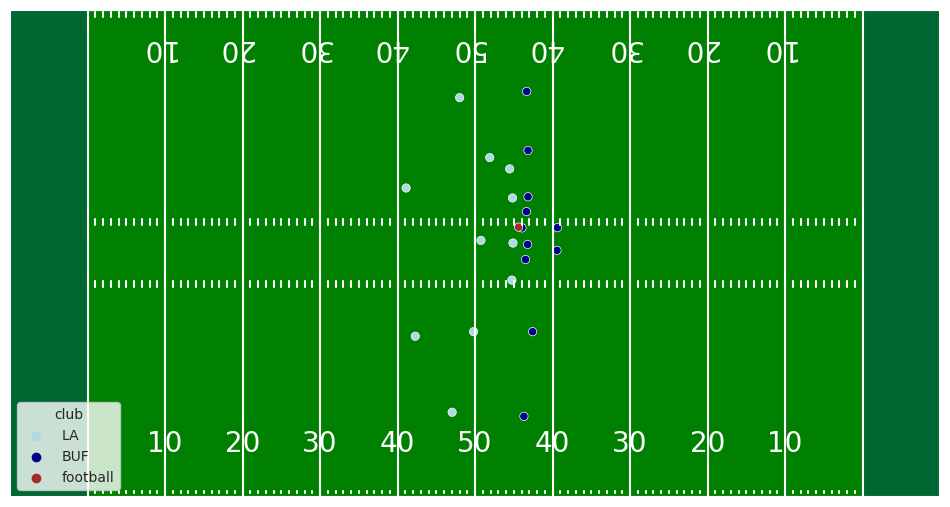

In [ ]:
#Football Field
fig, ax = create_football_field()
plot = sns.scatterplot(data=temp, x='x', y='y', hue='club', palette=['lightblue', 'darkblue', 'brown'])
plt.xlim(0, 120)
plt.ylim(0, 53.3)
plt.show()

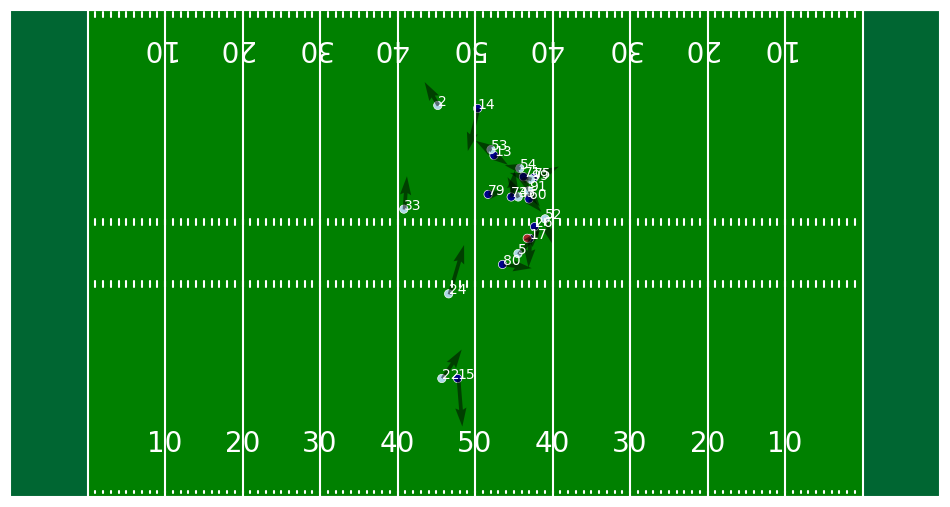

In [ ]:
#With Labels and Vectors
def frame(i, orient, metric):
    fig, ax = create_football_field()
    plot = sns.scatterplot(data=play_1[play_1['frameId'] == i], x='x', y='y', hue='club', palette=['lightblue', 'darkblue', 'brown'], legend=False)
    for index, row in play_1[play_1['frameId'] == i].iterrows():
        try:
            ax.text(row['x'], row['y'], int(row['jerseyNumber']), color='white')
            angle = math.radians(row[orient])
            x_length = row[metric] * math.cos(angle)
            y_length = row[metric] * math.sin(angle)
            ax.quiver(row['x'], row['y'], x_length, y_length, angles='xy', scale_units='xy',width=0.004, scale=1, alpha=0.5)
        except ValueError:
            continue
    plt.xlim(0, 120)
    plt.ylim(0, 53.3)
    plt.savefig(f'frame_{i}.png')
    #plt.show()
frame(30, 'o', 's')

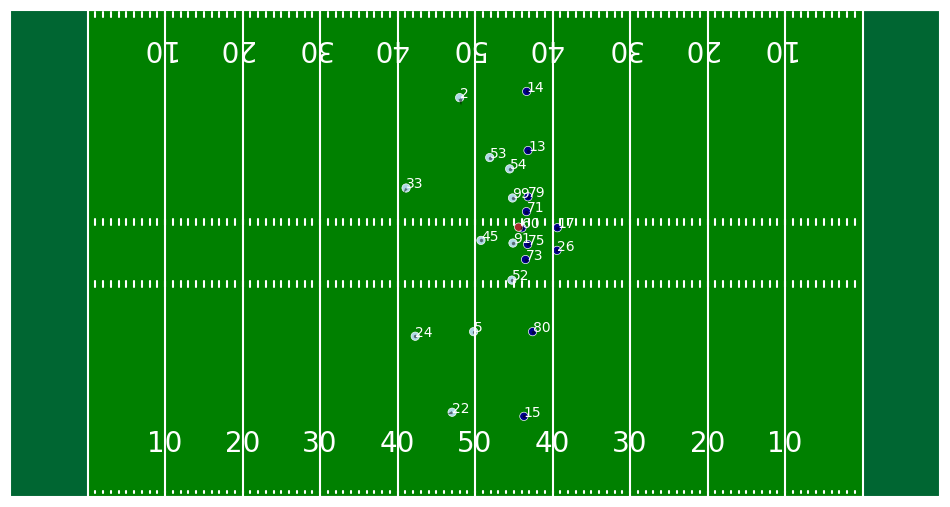

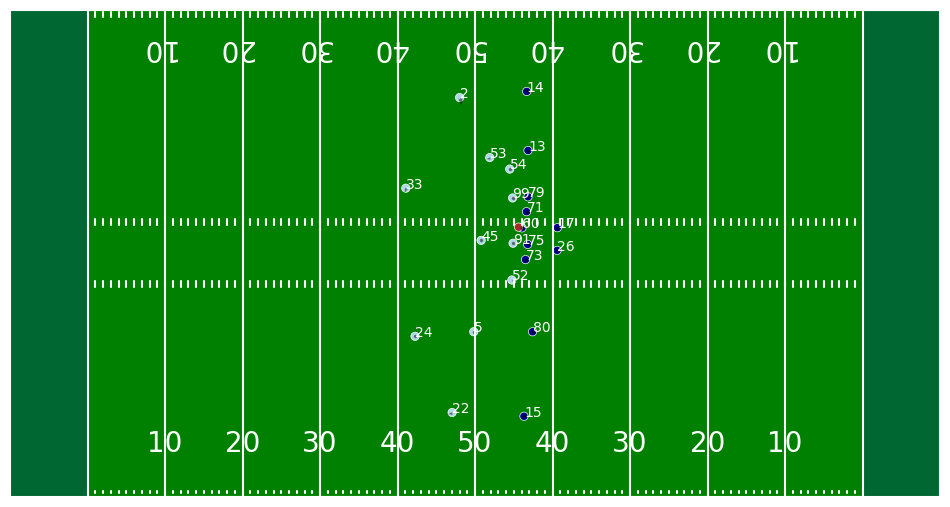

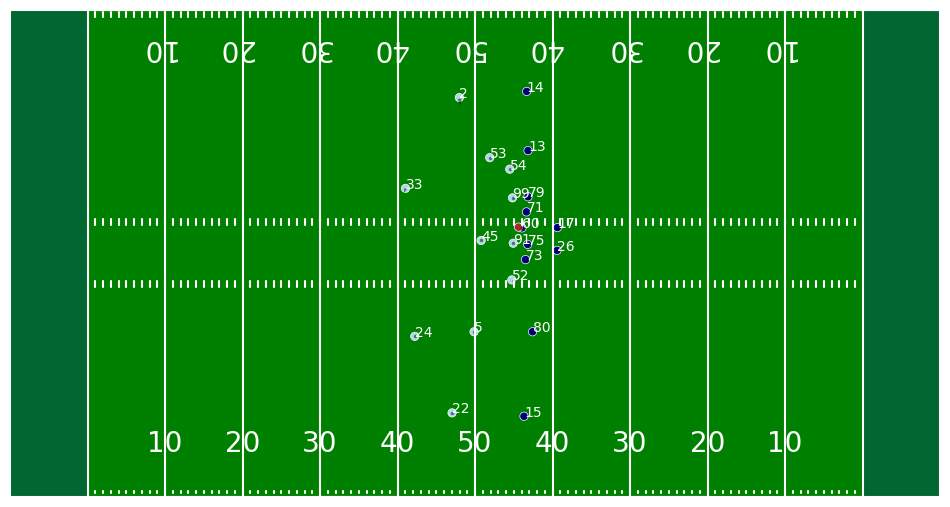

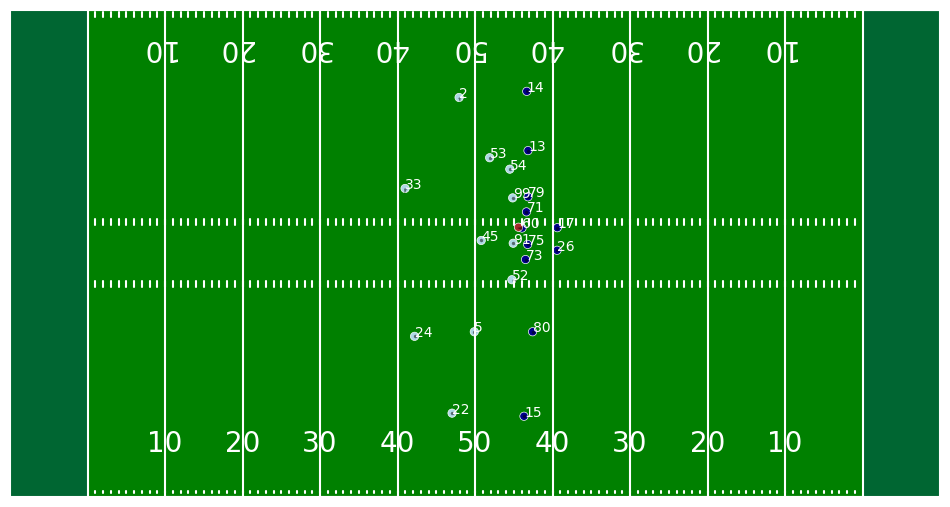

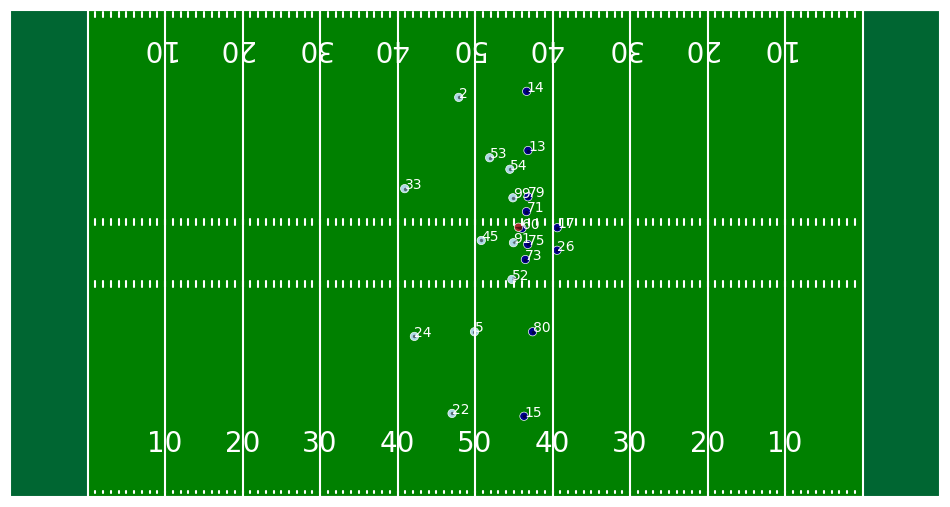

...

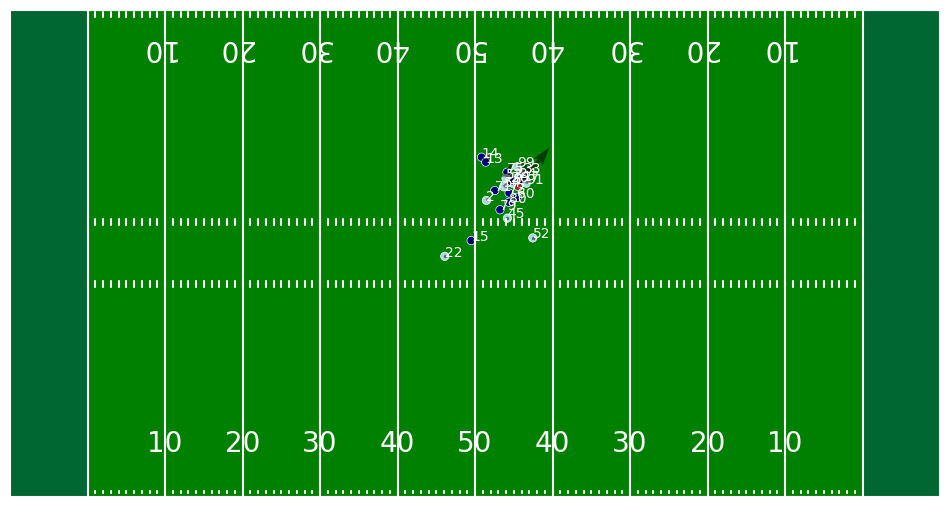

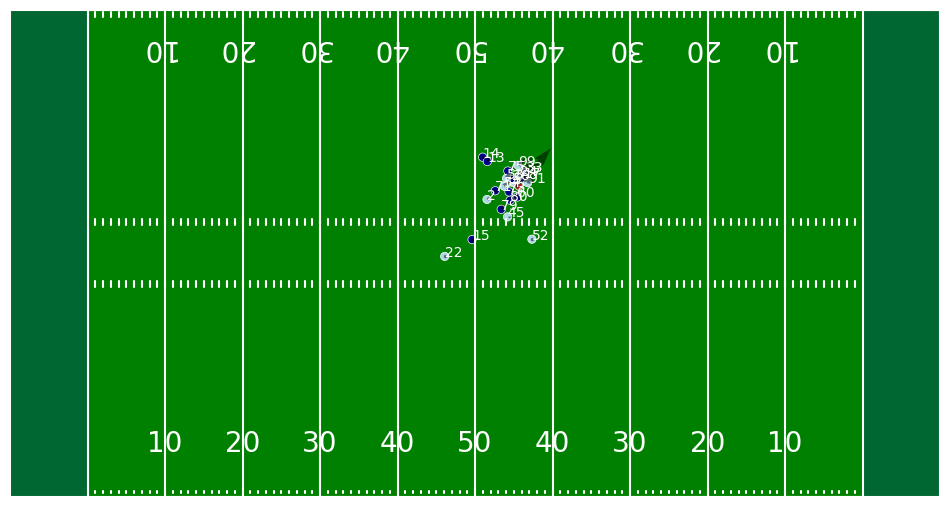

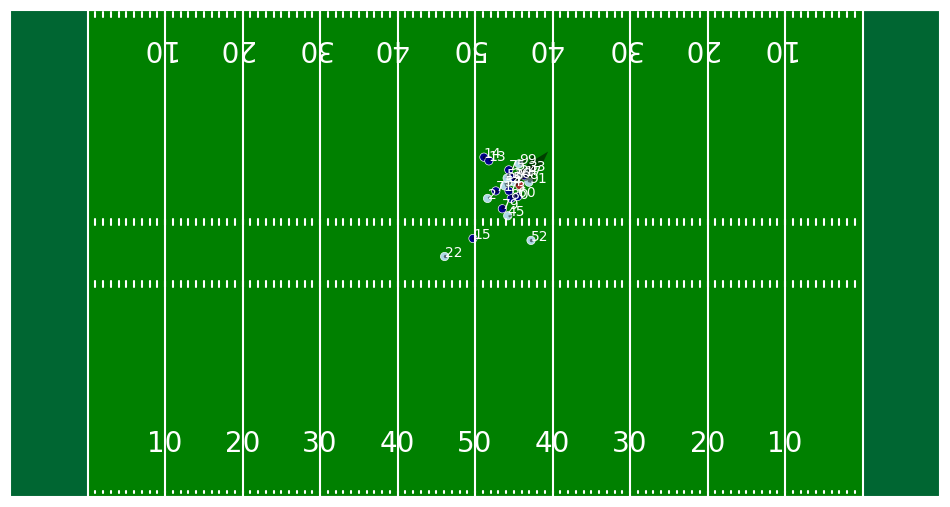

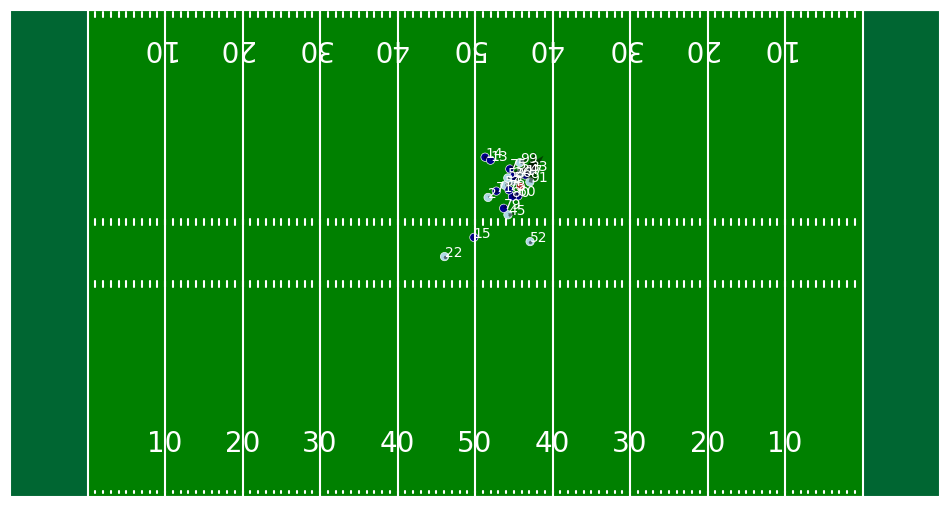

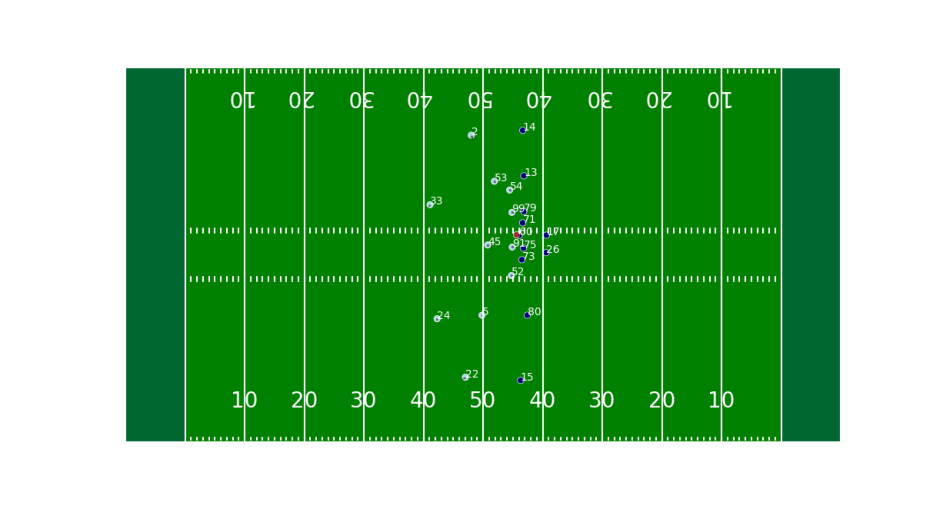

In [ ]:
video = []
for i in play_1['frameId'].unique():
    #frame(i, 'o', 'dis')
    #frame(i, 'o', 's')
    #frame(i, 'o', 'a')
    #frame(i, 'dir', 'dis')
    #frame(i, 'dir', 's')
    frame(i, 'dir', 'a')
    video.append(Image.open(f'frame_{i}.png'))
fig = plt.figure(figsize=(12, 6.33))
im = plt.imshow(video[0])
plt.axis('off')
def animate_func(i):
    im.set_array(video[i])
    return [im]
anim = animation.FuncAnimation(fig, animate_func, frames = len(video), interval = 1000 // 12)
HTML(anim.to_html5_video())

## Pitch and Player Heatmap

In [ ]:
import random
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import statsmodels.api as sm # using linear regression library for analysis
from scipy.stats import pearsonr # calculating pearson correlation

# ployly is the main tool for visualization in this notebook
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# make sure the code in plotly is able to run properly
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=True)

# Style for the visualization
fonts = ['Rockwell','Oswald','Lato']
colors = ['#013369','#013f82','#0264ce','#d50a0a','#ffffff']

# remove unnecessary warnings in the output
pd.options.mode.chained_assignment = None  # default='warn'

players = pd.read_csv("kaggle_data/players.csv")
# to make it simple at the beginning, I will use the week 1 data only for now
tracking = pd.read_csv("kaggle_data/tracking_week_1.csv")

player_position = players.groupby(['position']).nunique().reset_index()[['position','nflId']].rename(columns = {"nflId":"nr_players"}).sort_values(by = 'nr_players',ascending = False)
# visualize the chart
fig = go.Figure()
fig.add_trace(
    go.Bar(
        x=player_position['position'],
        y=player_position['nr_players'],
        hovertemplate = '<i>Nr. of players</i>: %{y}',
        marker_color=colors[0]
          )
)

# update chart layout
fig.update_layout(
                  title_text="Number of NFL players by position (2024)",
                  paper_bgcolor='white',
                  plot_bgcolor='white',
                  font=dict(
                            family=fonts[0],
                            size=14
                  ),
                  xaxis_tickfont_size=14,
                  yaxis=dict(
                          titlefont_size=16,
                          tickfont_size=14,
                    ),
                  hoverlabel=dict(
                    bgcolor="white",
                    font_size=14,
                    font_family="Rockwell"
                    ),
                  bargap=0.05,
                  bargroupgap=0.05
)

fig.update_xaxes(title_text="Position")
fig.update_yaxes(title_text="Nr. of players")

fig.show(renderer = 'colab')

In [ ]:
# remove ball tracking
tracking_no_ball = tracking.loc[tracking['displayName'] != 'football']
# merge and get relevant columns
player_tracking = players.merge(
                                    tracking_no_ball,
                                    how = 'inner',
                                    on = 'nflId')[['nflId',
                                                   'playId',
                                                   'position',
                                                   'time',
                                                   'x',
                                                   'y',
                                                   'event']]
# adopted yard as the measure unit

FIELD_HEIGHT = 53.3
FIELD_WIDTH = 120

ENDZONE_WIDTH = 10
ENDZONE_HEIGHT = FIELD_HEIGHT
ENDZONE_LINE_WIDTH = 0.2
ENDZONE_COLOR = 'gray'
ENDZONE_ANNOTATION_SIZE = 20

FIELD_ANNOTATION_COLOR = 'white'
FIELD_ANNOTATION_SIZE = 15
YARD_NUMBER_SIZE = FIELD_ANNOTATION_SIZE

SIDELINE_COLOR = 'white'
SIDELINE_WIDTH = 1

YARDLINE_COLOR = 'white'
YARDLINE_WIDTH = 2
YARD_NUMBER_COLOR = 'white'

GOAL_POST_WIDTH = 2.5
GOAL_POST_COLOR = 'yellow'

BALL_SIZE = 3
BALL_COLOR = "#A27C5B" # natural brown

GROUND_COLOR = "#96b78c"
PLOT_COLOR = "#96b78c"


SCREEN_ADJUST = 9 # Make sure the field height and width will expand or shrink at a same scale
LAYOUT_MARGIN_TOP = 10
LAYOUT_MARGIN_RIGHT = 5
LAYOUT_MARGIN_BOTTOM = 10
LAYOUT_MARGIN_LEFT = 5
PAD = 0.4

def draw_tracking(position):
    position_tracking = player_tracking.loc[player_tracking['position'] == position]
    nr_player = player_position.loc[player_position['position'] == position]['nr_players'].iloc[0]
    fig = go.Figure(
                    data=go.Histogram2d(
                                        x=position_tracking['x'],
                                        y=position_tracking['y'],
                                        autobinx=False,
                                        xbins=dict(start=0,
                                                   end=120,
                                                   size=1
                                                    ),
                                        autobiny=False,
                                        ybins=dict(start=0,
                                                   end=53.3,
                                                   size=53.3 / 60
                                        ))
               )


    # end zones
    fig.add_shape(
                    type="rect",
                    x0=0,
                    y0=0,
                    x1=10,
                    y1=53.3,
                    line=dict(
                                color=ENDZONE_COLOR,
                                width=ENDZONE_LINE_WIDTH,
                            ),
                    fillcolor=ENDZONE_COLOR,
                    opacity = 0.25
    )

    fig.add_shape(
                    type="rect",
                    x0=110,
                    y0=0,
                    x1=120,
                    y1=53.3,
                    line=dict(
                                color=ENDZONE_COLOR,
                                width=ENDZONE_LINE_WIDTH,
                    ),
                    fillcolor=ENDZONE_COLOR,
                    opacity = 0.25
    )

    # add end zone annotation
    fig.add_annotation(
                        text="Home Endzone",
                        x=5,
                        y=26.5,
                        showarrow=False,
                        font = dict(
                                  size = ENDZONE_ANNOTATION_SIZE,
                                  color = 'white'
                        ),
                        opacity = 0.8,
                        textangle=-90
                        )

    fig.add_annotation(
                        text="Visitor Endzone",
                        x=115,
                        y=26.5,
                        showarrow=False,
                        font = dict(
                                  size = ENDZONE_ANNOTATION_SIZE,
                                  color = 'white'
                        ),
                        opacity = 0.8,
                        textangle=90
                     )

    # major yard lines
    for i in range(11):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 10,
                        y0= 0,
                        x1= (i + 1) * 10,
                        y1= 53.5,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                 )
                     )

    for i in range(10):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 10 + 5,
                        y0= 0,
                        x1= (i + 1) * 10 + 5,
                        y1= 53.5,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                )
                      )

    # minor yard lines
    for i in range(100):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 1 + 10,
                        y0= 51,
                        x1= (i + 1) * 1 + 10,
                        y1= 53.3,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                 )
                    )

    for i in range(100):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 1 + 10,
                        y0= 33,
                        x1= (i + 1) * 1 + 10,
                        y1= 35.3,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                )
                    )


    for i in range(100):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 1 + 10,
                        y0= 18,
                        x1= (i + 1) * 1 + 10,
                        y1= 20.3,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                )
                        )

    for i in range(100):
        fig.add_shape(
                        type="line",
                        x0= (i + 1) * 1 + 10,
                        y0= 0,
                        x1= (i + 1) * 1 + 10,
                        y1= 2.3,
                        layer="below",
                        line=dict(
                                    color=YARDLINE_COLOR,
                                    width=YARDLINE_WIDTH
                                )
                        )

    # add yard line number & text for the upper sideline
    for i in range(9):
        fig.add_annotation(
                            text="0",
                            x = (i+2) * 10 + 1,
                            y = 3,
                            showarrow=False,
                            font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                        )
                            )

        fig.add_annotation(
                            text="0",
                            x = (i+2) * 10 - 1,
                            y = 50.3,
                            showarrow=False,
                            font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                        ),
                           textangle=180)

    for i in range(5):
        fig.add_annotation(
                            text= str(i+1),
                            x = (i+2) * 10 - 1,
                            y = 3,
                            showarrow=False,
                            font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                        )
                            )
        fig.add_annotation(
                            text= str(i+1),
                            x= (i+2) * 10 + 1,
                            y = 50.3,
                            showarrow=False,
                            font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                        ),
                            textangle=180
                           )

    # add yard line number for the lower sideline
    for i in range(4):
        fig.add_annotation(
                            text= str(5 - (i+1)),
                            x= (i+7) * 10 - 1,
                            y = 3,
                            showarrow=False,
                            font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                        )
                                    )
        fig.add_annotation(text= str(5 - (i+1)),
                           x= (i+7) * 10 + 1,
                           y = 50.3,
                           showarrow=False,
                           font = dict(
                                        size = YARD_NUMBER_SIZE,
                                        color = YARDLINE_COLOR
                                       ),
                           textangle=180
                           )

    # add goal zone line
    fig.add_annotation(
                           text= "G",
                           x=  11,
                           y = 3,
                           showarrow=False,
                           font = dict(
                                       size = YARD_NUMBER_SIZE,
                                       color = YARDLINE_COLOR
                           )
                      )
    fig.add_annotation(
                           text= "G",
                           x= 11,
                           y = 50.3,
                           showarrow=False,
                           font = dict(
                                       size = YARD_NUMBER_SIZE,
                                       color = YARDLINE_COLOR
                           ),
                          textangle=180
                    )

    fig.add_annotation(
                           text= "G",
                           x=  109,
                           y = 3,
                           showarrow=False,
                           font = dict(
                                       size = YARD_NUMBER_SIZE,
                                       color = YARDLINE_COLOR
                           )
                    )

    fig.add_annotation(
                           text= "G",
                           x= 109,
                           y = 50.3,
                           showarrow=False,
                           font = dict(
                                       size = YARD_NUMBER_SIZE,
                                       color = YARDLINE_COLOR
                            ),
                      textangle=180
                    )

    # add goal post
    fig.add_shape(
                    type="line",
                    x0=0,
                    y0=22.8,
                    x1=0,
                    y1=27.8,
                    line=dict(
                            color=GOAL_POST_COLOR,
                            width=GOAL_POST_WIDTH
                    )
                )

    fig.add_shape(
                    type="line",
                    x0=120,
                    y0=22.8,
                    x1=120,
                    y1=27.8,
                    line=dict(
                            color=GOAL_POST_COLOR,
                            width=GOAL_POST_WIDTH
                    )
                )


    fig.update_xaxes(
                     showgrid=False, # remove x gridlines
                     visible=False, # make x axis invisible
                     showticklabels=False # make x axis tick invisible
                    )
    fig.update_yaxes(
                     showgrid=False, # remove y gridlines
                     visible=False, # make y axis invisible
                     showticklabels=False # make y axis tick invisible
                    )


    fig.update_layout(
                        width=120 * SCREEN_ADJUST, # 120 yards wide
                        height=53.3 * SCREEN_ADJUST, # 53.3 yards high
                        margin=dict(
                                    l=LAYOUT_MARGIN_LEFT * SCREEN_ADJUST,
                                    r=LAYOUT_MARGIN_RIGHT * SCREEN_ADJUST,
                                    b=LAYOUT_MARGIN_BOTTOM * SCREEN_ADJUST,
                                    t=LAYOUT_MARGIN_TOP * SCREEN_ADJUST,
                                    pad=PAD * SCREEN_ADJUST
                        )

                    )

    # add sidelines for the field
    fig.add_shape(
                    type="line",
                    x0=0,
                    y0=0,
                    x1=120,
                    y1=0,
                    line=dict(
                                color=SIDELINE_COLOR,
                                width=SIDELINE_WIDTH
                    )
                )


    fig.add_shape(
                    type="line",
                    x0=120,
                    y0=0,
                    x1=120,
                    y1=53.3,
                    line=dict(
                                color=SIDELINE_COLOR,
                                width=SIDELINE_WIDTH
                    )
                )


    fig.add_shape(
                    type="line",
                    x0=0,
                    y0=0,
                    x1=0,
                    y1=53.3,
                    line=dict(
                                color=SIDELINE_COLOR,
                                width=SIDELINE_WIDTH
                    )
                )


    fig.add_shape(
                    type="line",
                    x0=0,
                    y0=53.3,
                    x1=120,
                    y1=53.3,
                    line=dict(
                                color=SIDELINE_COLOR,
                                width=SIDELINE_WIDTH
                    )
    )



    # change color of the background into green
    fig.update_layout(
                        title = "Tracking heapmap of {nr_player} {position} players".format(nr_player = nr_player,
                                                                                           position = position),
                        font=dict(
                                family=fonts[0],
                                size=18,
                                color=colors[0]
                    ),
                        paper_bgcolor='#96b78c',
                        plot_bgcolor="#96b78c"
                    )

    fig.show(renderer = 'colab')

draw_tracking("C")


In [ ]:
draw_tracking("CB")
draw_tracking("QB")
draw_tracking("DE")
draw_tracking("DT")
draw_tracking("FB")
draw_tracking("WR")
draw_tracking("NT")
draw_tracking("RB")
draw_tracking("TE")
draw_tracking("T")
draw_tracking("G")
draw_tracking("OLB")
draw_tracking("ILB")
draw_tracking("MLB")
draw_tracking("FS")
draw_tracking("SS")

# 8. More animations

In [ ]:
import pandas as pd
import numpy as np

# Read In csvs
games = pd.read_csv("kaggle_data/games.csv")
plays = pd.read_csv("kaggle_data/plays.csv")
players = pd.read_csv("kaggle_data/players.csv").drop("displayName",axis=1)
week1 = pd.read_csv("kaggle_data/tracking_week_1.csv")
tackles = pd.read_csv("kaggle_data/tackles.csv")
joined_all = pd.merge(games,plays,how="inner",on = "gameId")
joined_all = pd.merge(joined_all,week1,how="inner",on=["gameId","playId"])
joined_all = pd.merge(joined_all,tackles,how="left",on=["gameId","playId","nflId"])
# left join on players to keep football records
joined_all = pd.merge(joined_all,players,how="left",on = "nflId")
play_focus = 2184
focused_df = joined_all[(joined_all.playId==play_focus)]
import plotly.graph_objects as go
fig = go.Figure( layout_yaxis_range=[0,53.3], layout_xaxis_range=[0,120])

colors = {"LA":'#003594',
          "BUF":'#C60C30',
          "football":"#CBB67C"
        }
for team in focused_df.club.unique():
    plot_df = focused_df[(focused_df.club==team)&(focused_df.frameId==1)]
    fig.add_trace(go.Scatter(x=plot_df["x"], y=plot_df["y"],mode = 'markers',marker_color=colors[team],name=team))
fig.show(renderer = 'colab')

In [ ]:
colors = {
    'ARI':["#97233F","#000000","#FFB612"],
    'ATL':["#A71930","#000000","#A5ACAF"],
    'BAL':["#241773","#000000"],
    'BUF':["#00338D","#C60C30"],
    'CAR':["#0085CA","#101820","#BFC0BF"],
    'CHI':["#0B162A","#C83803"],
    'CIN':["#FB4F14","#000000"],
    'CLE':["#311D00","#FF3C00"],
    'DAL':["#003594","#041E42","#869397"],
    'DEN':["#FB4F14","#002244"],
    'DET':["#0076B6","#B0B7BC","#000000"],
    'GB' :["#203731","#FFB612"],
    'HOU':["#03202F","#A71930"],
    'IND':["#002C5F","#A2AAAD"],
    'JAX':["#101820","#D7A22A","#9F792C"],
    'KC' :["#E31837","#FFB81C"],
    'LA' :["#003594","#FFA300","#FF8200"],
    'LAC':["#0080C6","#FFC20E","#FFFFFF"],
    'LV' :["#000000","#A5ACAF"],
    'MIA':["#008E97","#FC4C02","#005778"],
    'MIN':["#4F2683","#FFC62F"],
    'NE' :["#002244","#C60C30","#B0B7BC"],
    'NO' :["#101820","#D3BC8D"],
    'NYG':["#0B2265","#A71930","#A5ACAF"],
    'NYJ':["#125740","#000000","#FFFFFF"],
    'PHI':["#004C54","#A5ACAF","#ACC0C6"],
    'PIT':["#FFB612","#101820"],
    'SEA':["#002244","#69BE28","#A5ACAF"],
    'SF' :["#AA0000","#B3995D"],
    'TB' :["#D50A0A","#FF7900","#0A0A08"],
    'TEN':["#0C2340","#4B92DB","#C8102E"],
    'WAS':["#5A1414","#FFB612"],
    'football':["#CBB67C","#663831"]
}

def hex_to_rgb_array(hex_color):
    '''take in hex val and return rgb np array'''
    return np.array(tuple(int(hex_color.lstrip('#')[i:i+2], 16) for i in (0, 2, 4)))

def ColorDistance(hex1,hex2):
    '''d = {} distance between two colors(3)'''
    if hex1 == hex2:
        return 0
    rgb1 = hex_to_rgb_array(hex1)
    rgb2 = hex_to_rgb_array(hex2)
    rm = 0.5*(rgb1[0]+rgb2[0])
    d = abs(sum((2+rm,4,3-rm)*(rgb1-rgb2)**2))**0.5
    return d

def ColorPairs(team1,team2):
    color_array_1 = colors[team1]
    color_array_2 = colors[team2]
    # If color distance is small enough then flip color order
    if ColorDistance(color_array_1[0],color_array_2[0])<500:
        return {team1:[color_array_1[0],color_array_1[1]],team2:[color_array_2[1],color_array_2[0]],'football':colors['football']}
    else:
        return {team1:[color_array_1[0],color_array_1[1]],team2:[color_array_2[0],color_array_2[1]],'football':colors['football']}

fig = go.Figure( layout_yaxis_range=[0,53.3], layout_xaxis_range=[0,120])

team_combos = list(set(focused_df.club.unique())-set(["football"]))
color_orders = ColorPairs(team_combos[0],team_combos[1])
for team in focused_df.club.unique():
    plot_df = focused_df[(focused_df.club==team)&(focused_df.frameId==1)]
    fig.add_trace(go.Scatter(x=plot_df["x"], y=plot_df["y"],marker=go.scatter.Marker(color=color_orders[team][0],
                                                                                     line=go.scatter.marker.Line(width=2,
                                                                                                                 color=color_orders[team][1]),
                                                                                     size=10),
                             mode = 'markers',
                             name=team))
fig.show(renderer = 'colab')

In [ ]:
def animate_play(games,tracking_df,play_df,players,gameId,playId):
    selected_game_df = games[games.gameId==gameId].copy()
    selected_play_df = play_df[(play_df.playId==playId)&(play_df.gameId==gameId)].copy()

    tracking_players_df = pd.merge(tracking_df,players,how="left",on = "nflId")
    selected_tracking_df = tracking_players_df[(tracking_players_df.playId==playId)&(tracking_players_df.gameId==gameId)].copy()

    sorted_frame_list = selected_tracking_df.frameId.unique()
    sorted_frame_list.sort()

    # get good color combos
    team_combos = list(set(selected_tracking_df.club.unique())-set(["football"]))
    color_orders = ColorPairs(team_combos[0],team_combos[1])

    # get play General information
    line_of_scrimmage = selected_play_df.absoluteYardlineNumber.values[0]
    ## Fixing first down marker issue from last year
    if selected_tracking_df.playDirection.values[0] == "right":
        first_down_marker = line_of_scrimmage + selected_play_df.yardsToGo.values[0]
    else:
        first_down_marker = line_of_scrimmage - selected_play_df.yardsToGo.values[0]
    down = selected_play_df.down.values[0]
    quarter = selected_play_df.quarter.values[0]
    gameClock = selected_play_df.gameClock.values[0]
    playDescription = selected_play_df.playDescription.values[0]
    # Handle case where we have a really long Play Description and want to split it into two lines
    if len(playDescription.split(" "))>15 and len(playDescription)>115:
        playDescription = " ".join(playDescription.split(" ")[0:16]) + "<br>" + " ".join(playDescription.split(" ")[16:])

    # initialize plotly start and stop buttons for animation
    updatemenus_dict = [
        {
            "buttons": [
                {
                    "args": [None, {"frame": {"duration": 100, "redraw": False},
                                "fromcurrent": True, "transition": {"duration": 0}}],
                    "label": "Play",
                    "method": "animate"
                },
                {
                    "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                      "mode": "immediate",
                                      "transition": {"duration": 0}}],
                    "label": "Pause",
                    "method": "animate"
                }
            ],
            "direction": "left",
            "pad": {"r": 10, "t": 87},
            "showactive": False,
            "type": "buttons",
            "x": 0.1,
            "xanchor": "right",
            "y": 0,
            "yanchor": "top"
        }
    ]
    # initialize plotly slider to show frame position in animation
    sliders_dict = {
        "active": 0,
        "yanchor": "top",
        "xanchor": "left",
        "currentvalue": {
            "font": {"size": 20},
            "prefix": "Frame:",
            "visible": True,
            "xanchor": "right"
        },
        "transition": {"duration": 300, "easing": "cubic-in-out"},
        "pad": {"b": 10, "t": 50},
        "len": 0.9,
        "x": 0.1,
        "y": 0,
        "steps": []
    }


    frames = []
    for frameId in sorted_frame_list:
        data = []
        # Add Numbers to Field
        data.append(
            go.Scatter(
                x=np.arange(20,110,10),
                y=[5]*len(np.arange(20,110,10)),
                mode='text',
                text=list(map(str,list(np.arange(20, 61, 10)-10)+list(np.arange(40, 9, -10)))),
                textfont_size = 30,
                textfont_family = "Courier New, monospace",
                textfont_color = "#ffffff",
                showlegend=False,
                hoverinfo='none'
            )
        )
        data.append(
            go.Scatter(
                x=np.arange(20,110,10),
                y=[53.5-5]*len(np.arange(20,110,10)),
                mode='text',
                text=list(map(str,list(np.arange(20, 61, 10)-10)+list(np.arange(40, 9, -10)))),
                textfont_size = 30,
                textfont_family = "Courier New, monospace",
                textfont_color = "#ffffff",
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Add line of scrimage
        data.append(
            go.Scatter(
                x=[line_of_scrimmage,line_of_scrimmage],
                y=[0,53.5],
                line_dash='dash',
                line_color='blue',
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Add First down line
        data.append(
            go.Scatter(
                x=[first_down_marker,first_down_marker],
                y=[0,53.5],
                line_dash='dash',
                line_color='yellow',
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Add Endzone Colors
        endzoneColors = {0:color_orders[selected_game_df.homeTeamAbbr.values[0]][0],
                         110:color_orders[selected_game_df.visitorTeamAbbr.values[0]][0]}
        for x_min in [0,110]:
            data.append(
                go.Scatter(
                    x=[x_min,x_min,x_min+10,x_min+10,x_min],
                    y=[0,53.5,53.5,0,0],
                    fill="toself",
                    fillcolor=endzoneColors[x_min],
                    mode="lines",
                    line=dict(
                        color="white",
                        width=3
                        ),
                    opacity=1,
                    showlegend= False,
                    hoverinfo ="skip"
                )
            )
        # Plot Players
        for team in selected_tracking_df.club.unique():
            plot_df = selected_tracking_df[(selected_tracking_df.club==team)&(selected_tracking_df.frameId==frameId)].copy()
            if team != "football":
                hover_text_array=[]
                for nflId in plot_df.nflId:
                    selected_player_df = plot_df[plot_df.nflId==nflId]
                    hover_text_array.append("nflId:{}<br>displayName:{}<br>Player Speed:{} yd/s".format(selected_player_df["nflId"].values[0],
                                                                                      selected_player_df["displayName"].values[0],
                                                                                      selected_player_df["s"].values[0]))
                data.append(go.Scatter(x=plot_df["x"], y=plot_df["y"],mode = 'markers',marker=go.scatter.Marker(
                                                                                             color=color_orders[team][0],
                                                                                             line=go.scatter.marker.Line(width=2,
                                                                                                            color=color_orders[team][1]),
                                                                                             size=10),
                                        name=team,hovertext=hover_text_array,hoverinfo="text"))
            else:
                data.append(go.Scatter(x=plot_df["x"], y=plot_df["y"],mode = 'markers',marker=go.scatter.Marker(
                                                                                             color=color_orders[team][0],
                                                                                             line=go.scatter.marker.Line(width=2,
                                                                                                            color=color_orders[team][1]),
                                                                                             size=10),
                                        name=team,hoverinfo='none'))
        # add frame to slider
        slider_step = {"args": [
            [frameId],
            {"frame": {"duration": 100, "redraw": False},
             "mode": "immediate",
             "transition": {"duration": 0}}
        ],
            "label": str(frameId),
            "method": "animate"}
        sliders_dict["steps"].append(slider_step)
        frames.append(go.Frame(data=data, name=str(frameId)))

    scale=10
    layout = go.Layout(
        autosize=False,
        width=120*scale,
        height=60*scale,
        xaxis=dict(range=[0, 120], autorange=False, tickmode='array',tickvals=np.arange(10, 111, 5).tolist(),showticklabels=False),
        yaxis=dict(range=[0, 53.3], autorange=False,showgrid=False,showticklabels=False),

        plot_bgcolor='#00B140',
        # Create title and add play description at the bottom of the chart for better visual appeal
        title=f"GameId: {gameId}, PlayId: {playId}<br>{gameClock} {quarter}Q"+"<br>"*19+f"{playDescription}",
        updatemenus=updatemenus_dict,
        sliders = [sliders_dict]
    )

    fig = go.Figure(
        data=frames[0]["data"],
        layout= layout,
        frames=frames[1:]
    )
    # Create First Down Markers
    for y_val in [0,53]:
        fig.add_annotation(
                x=first_down_marker,
                y=y_val,
                text=str(down),
                showarrow=False,
                font=dict(
                    family="Courier New, monospace",
                    size=16,
                    color="black"
                    ),
                align="center",
                bordercolor="black",
                borderwidth=2,
                borderpad=4,
                bgcolor="#ff7f0e",
                opacity=1
                )
    # Add Team Abbreviations in EndZone's
    for x_min in [0,110]:
        if x_min == 0:
            angle = 270
            teamName=selected_game_df.homeTeamAbbr.values[0]
        else:
            angle = 90
            teamName=selected_game_df.visitorTeamAbbr.values[0]
        fig.add_annotation(
            x=x_min+5,
            y=53.5/2,
            text=teamName,
            showarrow=False,
            font=dict(
                family="Courier New, monospace",
                size=32,
                color="White"
                ),
            textangle = angle
        )
    return fig

animate_play(games,week1,plays,players,2022090800,2184).show(renderer = 'colab')

In [ ]:
#Select random plays from 5 games
import random
for gameId in week1.gameId.unique()[0:5].tolist():
    plays_list = week1[week1.gameId==gameId].playId.unique().tolist()
    playId = random.choice(plays_list)
    animate_play(games,week1,plays,players,gameId,playId).show(renderer = 'colab')